In [154]:
import time
import pandas as pd
import json
import numpy as np
from datetime import datetime
from datetime import timezone
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter
from matplotlib.colors import ListedColormap
import numpy as np
# import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [155]:
def read_json_from_ros2bag(json_file, print_ = True):
    list_of_length = []
    with open(json_file, 'r') as file:
        json_content = json.load(file)
    if print_:
        print('Read: ',json_file)
    for key, value in json_content.items():
        if print_:
            print(f"{key} range: {len(value)}")
        list_of_length.append(len(value))
    cut_data = {key: value[:min(list_of_length)] for key, value in json_content.items()}
    cut_df = pd.DataFrame(cut_data)
    return cut_df
def read_and_normalize_json_from_ros2bag(json_file, print_=True):
    list_of_length = []
    with open(json_file, 'r') as f:
        data = json.load(f)
    if print_:
        print('Read: ',json_file)
    for key, value in data.items():
        if print_:
            print(f"{key} range: {len(value)}")
        list_of_length.append(len(value))
    # Normalize the data into a DataFrame
    df = pd.json_normalize(data)
    return df

def process_sensor_data(input_df, sensor_key, output_column, window_slide=1, shift=0):
    sensor_val = []
    sensor_ts = []
    sensor_df = []

    for i in range(len(input_df[sensor_key][0])):
        sensor_val.append(input_df[sensor_key][0][i]['val'])
        sensor_ts.append(input_df[sensor_key][0][i]['ts'])

    sensor_df = pd.DataFrame(sensor_val, columns=output_column)
    sensor_df = sensor_df.shift(shift)
    sensor_df = sensor_df.rolling(window=window_slide).mean()
    sensor_df['ts'] = sensor_ts

    return sensor_df

In [156]:
air_df                  = read_and_normalize_json_from_ros2bag('stick_insect_air_0.json')
water_r900_df           = read_and_normalize_json_from_ros2bag('stick_insect_water_float_0.json')
water_r1200_df          = read_and_normalize_json_from_ros2bag('stick_insect_water_sink_1200_0.json')
water_r1800_df          = read_and_normalize_json_from_ros2bag('stick_insect_water_sink_1800_0.json')

Read:  stick_insect_air_0.json
joint_torque_output_fb range: 10892
joint_velocity_fb range: 10892
joint_damping_fb range: 10891
joint_stiffness_fb range: 10892
foot_force_feedback range: 10892
joint_torque_feedforward_fb range: 10892
joint_angle_fb range: 10892
joint_angle_commands range: 2533
expected_foot_force range: 2435
Read:  stick_insect_water_float_0.json
joint_angle_fb range: 13162
joint_velocity_fb range: 13162
expected_foot_force range: 3108
joint_angle_commands range: 3206
joint_torque_feedforward_fb range: 13162
foot_force_feedback range: 13162
joint_torque_output_fb range: 13162
joint_stiffness_fb range: 13162
joint_damping_fb range: 13162
Read:  stick_insect_water_sink_1200_0.json
joint_torque_feedforward_fb range: 8871
foot_force_feedback range: 8870
joint_velocity_fb range: 8871
joint_stiffness_fb range: 8870
joint_angle_fb range: 8870
joint_angle_commands range: 2066
joint_torque_output_fb range: 8870
joint_damping_fb range: 8870
expected_foot_force range: 1968
Read: 

## Pre-processing

In [157]:
# import pandas as pd
# import numpy as np

# # 1. Define your 18 Joint Names (Order is critical!)
# # Ensure this matches the order of the data inside the 'val' list
# joint_names = [
#     'TR0', 'TR1', 'TR2', 
#     'CR0', 'CR1', 'CR2', 
#     'FR0', 'FR1', 'FR2', 
#     'TL0', 'TL1', 'TL2', 
#     'CL0', 'CL1', 'CL2', 
#     'FL0', 'FL1', 'FL2'
# ]

# def clean_and_expand_data(df, target_col, new_col_names):
#     """
#     Extracts the list of floats from the nested dictionary structure:
#     [{'val': [0.1, 0.2, ...]}]  ->  Columns: TR0, TR1...
#     """
#     # Helper function to extract the list safely
#     def extract_val(cell):
#         try:
#             # Access list index 0, then dict key 'val'
#             return cell[0]['val'] 
#         except (IndexError, KeyError, TypeError):
#             # Return a list of NaNs if data is missing/corrupt
#             return [np.nan] * len(new_col_names)

#     # 1. Apply extraction to get a Series of lists
#     list_series = df[target_col].apply(extract_val)
    
#     # 2. Convert that Series of lists into a DataFrame with proper column names
#     expanded_df = pd.DataFrame(list_series.tolist(), columns=new_col_names, index=df.index)
    
#     # 3. Add the timestamp if it exists in the original df
#     if 'ts' in df.columns:
#         expanded_df['ts'] = df['ts']
#     elif 'timestamp' in df.columns:
#         expanded_df['ts'] = df['timestamp']
        
#     return expanded_df

# # --- USAGE EXAMPLE ---

# # Apply this to your DataFrames (air, water, etc.)
# # Example for Joint Angles:
# air_joint_angle_fb_df = clean_and_expand_data(air_df, 'joint_angle_fb', joint_names)
# water_r900_joint_angle_fb_df = clean_and_expand_data(water_r900_df, 'joint_angle_fb', joint_names)

# # Example for Torques (if you want to plot those later):
# air_torque_df = clean_and_expand_data(air_df, 'joint_torque_feedforward_fb', joint_names)

# # Now apply the slice (cut head/tail)
# # Slicing: Start at index 5000, go up to the last 2000 rows
# # This overwrites the original variables with the sliced version
# air_df = air_df[5000:-2000]
# water_r900_df = water_r900_df[5000:-2000]
# water_r1200_df = water_r1200_df[5000:-2000]
# water_r1800_df = water_r1800_df[5000:-2000]

# # OPTIONAL: Reset the index
# # If you don't do this, your index will start at 5000 (e.g., 5000, 5001, 5002...)
# # Resetting makes it start at 0 again.
# air_df.reset_index(drop=True, inplace=True)
# water_r900_df.reset_index(drop=True, inplace=True)
# water_r1200_df.reset_index(drop=True, inplace=True)
# water_r1800_df.reset_index(drop=True, inplace=True)

# # Check the result
# # print(air_joint_angle_fb_df.head())

In [158]:
print(air_joint_angle_fb_df)

       TR0       TR1       TR2       CR0       CR1       CR2       FR0  \
0  0.00226 -0.012719  0.012144 -0.001322 -0.014581  0.011449 -0.001142   

        FR1       FR2       TL0       TL1       TL2       CL0       CL1  \
0 -0.015489  0.015053  0.003268 -0.011575  0.011906 -0.000686 -0.013824   

        CL2       FL0       FL1       FL2  
0  0.011887 -0.001365 -0.014437  0.014881  


In [159]:
name_joints = ['TR0', 'TR1', 'TR2', 'CR0', 'CR1', 'CR2', 'FR0', 'FR1', 'FR2', 'TL0', 'TL1', 'TL2', 'CL0', 'CL1', 'CL2', 'FL0', 'FL1', 'FL2']
name_foots = ['R0', 'R1', 'R2', 'L0', 'L1', 'L2']

In [160]:
shift = 0
window_slide = 100

air_joint_angle_commands_df                 = process_sensor_data(air_df, 'joint_angle_commands', name_joints, window_slide, shift)
air_joint_angle_fb_df                       = process_sensor_data(air_df, 'joint_angle_fb', name_joints, window_slide, shift)

air_joint_velocity_fb_df                    = process_sensor_data(air_df, 'joint_velocity_fb', name_joints, window_slide, shift)

air_joint_torque_output_fb_df               = process_sensor_data(air_df, 'joint_torque_output_fb', name_joints, window_slide, shift)
air_joint_torque_feedforward_fb_df          = process_sensor_data(air_df, 'joint_torque_feedforward_fb', name_joints, window_slide, shift)
air_joint_stiffness_fb_df                   = process_sensor_data(air_df, 'joint_stiffness_fb', name_joints, window_slide, shift)
air_joint_damping_fb_df                     = process_sensor_data(air_df, 'joint_damping_fb', name_joints, window_slide, shift)

air_foot_force_feedback_df                  = process_sensor_data(air_df, 'foot_force_feedback', name_foots, window_slide, shift)

In [161]:
shift = 0
window_slide = 100

water_r900_joint_angle_commands_df                 = process_sensor_data(water_r900_df, 'joint_angle_commands', name_joints, window_slide, shift)
water_r900_joint_angle_fb_df                       = process_sensor_data(water_r900_df, 'joint_angle_fb', name_joints, window_slide, shift)

water_r900_joint_velocity_fb_df                    = process_sensor_data(water_r900_df, 'joint_velocity_fb', name_joints, window_slide, shift)

water_r900_joint_torque_output_fb_df               = process_sensor_data(water_r900_df, 'joint_torque_output_fb', name_joints, window_slide, shift)
water_r900_joint_torque_feedforward_fb_df          = process_sensor_data(water_r900_df, 'joint_torque_feedforward_fb', name_joints, window_slide, shift)
water_r900_joint_stiffness_fb_df                   = process_sensor_data(water_r900_df, 'joint_stiffness_fb', name_joints, window_slide, shift)
water_r900_joint_damping_fb_df                     = process_sensor_data(water_r900_df, 'joint_damping_fb', name_joints, window_slide, shift)

water_r900_foot_force_feedback_df                  = process_sensor_data(water_r900_df, 'foot_force_feedback', name_foots, window_slide, shift)

In [162]:
shift = 0
window_slide = 100

water_r1200_joint_angle_commands_df                 = process_sensor_data(water_r1200_df, 'joint_angle_commands', name_joints, window_slide, shift)
water_r1200_joint_angle_fb_df                       = process_sensor_data(water_r1200_df, 'joint_angle_fb', name_joints, window_slide, shift)

water_r1200_joint_velocity_fb_df                    = process_sensor_data(water_r1200_df, 'joint_velocity_fb', name_joints, window_slide, shift)

water_r1200_joint_torque_output_fb_df               = process_sensor_data(water_r1200_df, 'joint_torque_output_fb', name_joints, window_slide, shift)
water_r1200_joint_torque_feedforward_fb_df          = process_sensor_data(water_r1200_df, 'joint_torque_feedforward_fb', name_joints, window_slide, shift)
water_r1200_joint_stiffness_fb_df                   = process_sensor_data(water_r1200_df, 'joint_stiffness_fb', name_joints, window_slide, shift)
water_r1200_joint_damping_fb_df                     = process_sensor_data(water_r1200_df, 'joint_damping_fb', name_joints, window_slide, shift)

water_r1200_foot_force_feedback_df                  = process_sensor_data(water_r1200_df, 'foot_force_feedback', name_foots, window_slide, shift)

In [163]:
shift = 0
window_slide = 100

water_r1800_joint_angle_commands_df                 = process_sensor_data(water_r1800_df, 'joint_angle_commands', name_joints, window_slide, shift)
water_r1800_joint_angle_fb_df                       = process_sensor_data(water_r1800_df, 'joint_angle_fb', name_joints, window_slide, shift)

water_r1800_joint_velocity_fb_df                    = process_sensor_data(water_r1800_df, 'joint_velocity_fb', name_joints, window_slide, shift)

water_r1800_joint_torque_output_fb_df               = process_sensor_data(water_r1800_df, 'joint_torque_output_fb', name_joints, window_slide, shift)
water_r1800_joint_torque_feedforward_fb_df          = process_sensor_data(water_r1800_df, 'joint_torque_feedforward_fb', name_joints, window_slide, shift)
water_r1800_joint_stiffness_fb_df                   = process_sensor_data(water_r1800_df, 'joint_stiffness_fb', name_joints, window_slide, shift)
water_r1800_joint_damping_fb_df                     = process_sensor_data(water_r1800_df, 'joint_damping_fb', name_joints, window_slide, shift)

water_r1800_foot_force_feedback_df                  = process_sensor_data(water_r1800_df, 'foot_force_feedback', name_foots, window_slide, shift)

## Plots analyze

In [164]:


colors = {
    'air': 'red',
    'water_r900': 'blue',
    'water_r1200': 'dodgerblue',
    'water_r1800': 'darkblue'
}

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 1. Setup the figure with a 6x3 grid
# 18 plots total. 6 Rows (Legs R0-R2, L0-L2) x 3 Columns (Joints T, C, F)
fig = make_subplots(
    rows=6, cols=3, 
    subplot_titles=name_joints,  # Automatically titles each subplot
    vertical_spacing=0.03,
    horizontal_spacing=0.05
)

# 2. Iterate and plot
# Your list is ordered: T(R), C(R), F(R), T(L), C(L), F(L)
# We need to map this list index to the specific (row, col) in the grid.

for i, joint in enumerate(name_joints):
    # Logic to fill Column 1 (T), then Column 2 (C), then Column 3 (F)
    # But your list is grouped by joint type segments. 
    # Let's map them dynamically:
    
    # Calculate Column (1, 2, or 3) based on joint letter
    if 'T' in joint:
        c = 1
    elif 'C' in joint:
        c = 2
    elif 'F' in joint:
        c = 3
    
    # Calculate Row (1 to 6) based on leg ID (R0-R2 is 1-3, L0-L2 is 4-6)
    if 'R0' in joint: r = 1
    elif 'R1' in joint: r = 2
    elif 'R2' in joint: r = 3
    elif 'L0' in joint: r = 4
    elif 'L1' in joint: r = 5
    elif 'L2' in joint: r = 6
    
    # Add the trace to the specific row/col
    fig.add_trace(
        go.Scatter(
            x=air_joint_angle_fb_df['ts'],
            y=air_joint_angle_fb_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['air']),
            showlegend=False # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )
    
    fig.add_trace(
        go.Scatter(
            x=water_r900_joint_angle_fb_df['ts'],
            y=water_r900_joint_angle_fb_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['water_r900']),
            showlegend=False # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )
    
    fig.add_trace(
        go.Scatter(
            x=water_r1200_joint_angle_fb_df['ts'],
            y=water_r1200_joint_angle_fb_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['water_r1200']),
            showlegend=False # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )
    
    fig.add_trace(
        go.Scatter(
            x=water_r1800_joint_angle_fb_df['ts'],
            y=water_r1800_joint_angle_fb_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['water_r1800']),
            showlegend=False # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )

# 3. Update Layout
fig.update_layout(
    height=1200,  # Make it tall enough for 6 rows
    width=1000,
    title_text="Joint Angles: Column-wise (Col 1: Coxa, Col 2: Femur, Col 3: Tibia)",
    showlegend=False
)

fig.show()

In [165]:


colors = {
    'air': 'red',
    'water_r900': 'blue',
    'water_r1200': 'dodgerblue',
    'water_r1800': 'darkblue'
}

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 1. Setup the figure with a 6x3 grid
# 18 plots total. 6 Rows (Legs R0-R2, L0-L2) x 3 Columns (Joints T, C, F)
fig = make_subplots(
    rows=6, cols=3, 
    subplot_titles=name_joints,  # Automatically titles each subplot
    vertical_spacing=0.03,
    horizontal_spacing=0.05
)

# 2. Iterate and plot
# Your list is ordered: T(R), C(R), F(R), T(L), C(L), F(L)
# We need to map this list index to the specific (row, col) in the grid.

for i, joint in enumerate(name_joints):
    # Logic to fill Column 1 (T), then Column 2 (C), then Column 3 (F)
    # But your list is grouped by joint type segments. 
    # Let's map them dynamically:
    
    # Calculate Column (1, 2, or 3) based on joint letter
    if 'T' in joint:
        c = 1
    elif 'C' in joint:
        c = 2
    elif 'F' in joint:
        c = 3
    
    # Calculate Row (1 to 6) based on leg ID (R0-R2 is 1-3, L0-L2 is 4-6)
    if 'R0' in joint: r = 1
    elif 'R1' in joint: r = 2
    elif 'R2' in joint: r = 3
    elif 'L0' in joint: r = 4
    elif 'L1' in joint: r = 5
    elif 'L2' in joint: r = 6
    
    # Add the trace to the specific row/col
    fig.add_trace(
        go.Scatter(
            x=air_joint_torque_output_fb_df['ts'],
            y=air_joint_torque_output_fb_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['air']),
            showlegend=False # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )
    
    fig.add_trace(
        go.Scatter(
            x=water_r900_joint_torque_output_fb_df['ts'],
            y=water_r900_joint_torque_output_fb_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['water_r900']),
            showlegend=False # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )
    
    fig.add_trace(
        go.Scatter(
            x=water_r1200_joint_torque_output_fb_df['ts'],
            y=water_r1200_joint_torque_output_fb_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['water_r1200']),
            showlegend=False # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )
    
    fig.add_trace(
        go.Scatter(
            x=water_r1800_joint_torque_output_fb_df['ts'],
            y=water_r1800_joint_torque_output_fb_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['water_r1800']),
            showlegend=False # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )

# 3. Update Layout
fig.update_layout(
    height=1200,  # Make it tall enough for 6 rows
    width=1000,
    title_text="Joint Angles: Column-wise (Col 1: Coxa, Col 2: Femur, Col 3: Tibia)",
    showlegend=False
)

fig.show()

In [166]:

colors = {
    'air': 'red',
    'water_r900': 'blue',
    'water_r1200': 'dodgerblue',
    'water_r1800': 'darkblue'
}

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 1. Setup the figure with a 6x3 grid
# 18 plots total. 6 Rows (Legs R0-R2, L0-L2) x 3 Columns (Joints T, C, F)
fig = make_subplots(
    rows=6, cols=1, 
    # subplot_titles=name_joints,  # Automatically titles each subplot
    vertical_spacing=0.03,
    horizontal_spacing=0.05,
    shared_xaxes=True
)

# 2. Iterate and plot
# Your list is ordered: T(R), C(R), F(R), T(L), C(L), F(L)
# We need to map this list index to the specific (row, col) in the grid.

for i, joint in enumerate(name_foots):
    # Logic to fill Column 1 (T), then Column 2 (C), then Column 3 (F)
    # But your list is grouped by joint type segments. 
    # Let's map them dynamically:
    
    # Calculate Column (1, 2, or 3) based on joint letter
    c =1
    # if 'T' in joint:
    #     c = 1
    # elif 'C' in joint:
    #     c = 2
    # elif 'F' in joint:
    #     c = 3
    
    # Calculate Row (1 to 6) based on leg ID (R0-R2 is 1-3, L0-L2 is 4-6)
    if 'R0' in joint: r = 1
    elif 'R1' in joint: r = 2
    elif 'R2' in joint: r = 3
    elif 'L0' in joint: r = 4
    elif 'L1' in joint: r = 5
    elif 'L2' in joint: r = 6
    
    # Add the trace to the specific row/col
    fig.add_trace(
        go.Scatter(
            x=air_foot_force_feedback_df['ts'],
            y=air_foot_force_feedback_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['air']),
            showlegend=True # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )
    
    fig.add_trace(
        go.Scatter(
            x=water_r900_foot_force_feedback_df['ts'],
            y=water_r900_foot_force_feedback_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['water_r900']),
            showlegend=True # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )
    
    fig.add_trace(
        go.Scatter(
            x=water_r1200_foot_force_feedback_df['ts'],
            y=water_r1200_foot_force_feedback_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['water_r1200']),
            showlegend=True # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )
    
    fig.add_trace(
        go.Scatter(
            x=water_r1800_foot_force_feedback_df['ts'],
            y=water_r1800_foot_force_feedback_df[joint],
            name=f'q [{joint}]',
            line=dict(color=colors['water_r1800']),
            showlegend=True # Hide legend to avoid clutter (optional)
        ),
        row=r, col=c
    )

# 3. Update Layout
fig.update_layout(
    height=1200,  # Make it tall enough for 6 rows
    width=1000,
    title_text="",
    showlegend=True
)

fig.show()

## Plots

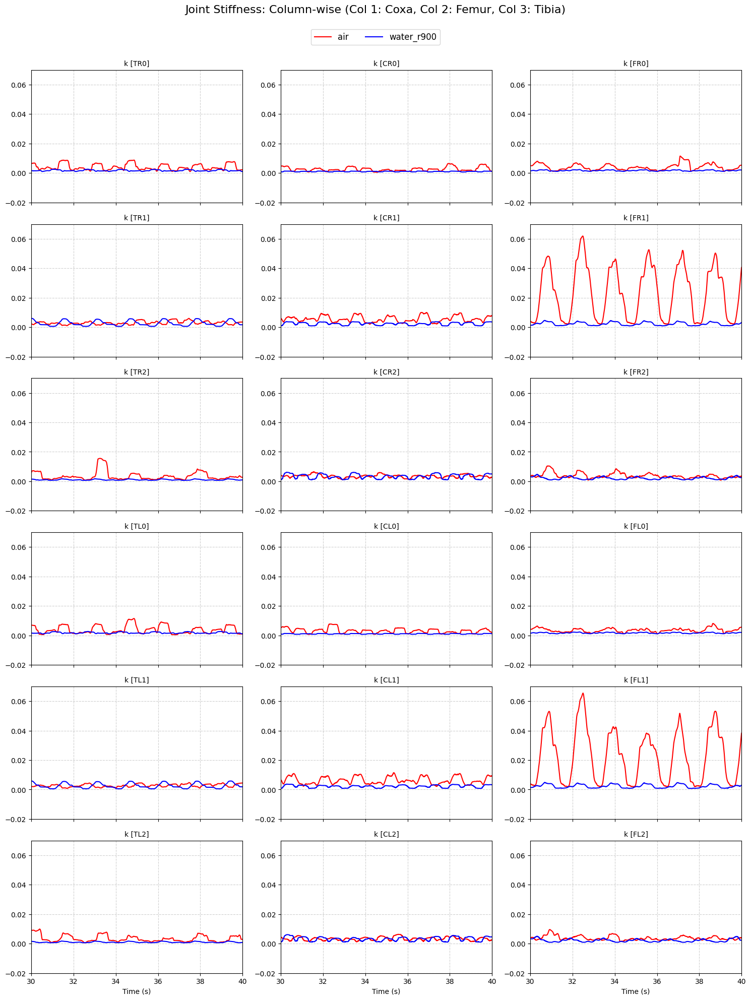

In [167]:
import matplotlib.pyplot as plt

# Define colors
colors = {
    'air': 'red',
    'water_r900': 'blue',
    'water_r1200': 'dodgerblue',
    'water_r1800': 'darkblue'
}

# Create the figure and axes (6 Rows x 3 Cols)
# figsize=(width, height) - adjusted to look similar to your Plotly height
fig, axs = plt.subplots(nrows=6, ncols=3, figsize=(15, 20), sharex=True)

# Flatten axes for easier iteration if needed, but we can access via [r, c]
# Set a main title
fig.suptitle("Joint Stiffness: Column-wise (Col 1: Coxa, Col 2: Femur, Col 3: Tibia)", fontsize=16)

# Lists to track if we have added labels to the legend yet
added_legend = False

for joint in name_joints:
    # --- 1. DETERMINE ROW & COLUMN (0-indexed) ---
    
    # Column Logic (Joint Type)
    if 'T' in joint:   c = 0 # Coxa
    elif 'C' in joint: c = 1 # Femur
    elif 'F' in joint: c = 2 # Tibia
    else: continue

    # Row Logic (Leg ID)
    if 'R0' in joint:   r = 0
    elif 'R1' in joint: r = 1
    elif 'R2' in joint: r = 2
    elif 'L0' in joint: r = 3
    elif 'L1' in joint: r = 4
    elif 'L2' in joint: r = 5
    else: continue

    # Select the specific subplot axis
    ax = axs[r, c]
    
    # --- 2. PLOT DATA ---
    # We only add the 'label' argument for the first plot we draw (r==0 and c==0)
    # This prevents the legend from having 18 duplicate entries.
    show_label = (r == 0 and c == 0)

    ax.plot(air_joint_stiffness_fb_df['ts'], air_joint_stiffness_fb_df[joint], 
            color=colors['air'], label='air' if show_label else "")
            
    ax.plot(water_r900_joint_stiffness_fb_df['ts'], water_r900_joint_stiffness_fb_df[joint], 
            color=colors['water_r900'], label='water_r900' if show_label else "")
            
#     ax.plot(water_r1200_joint_stiffness_fb_df['ts'], water_r1200_joint_stiffness_fb_df[joint], 
#             color=colors['water_r1200'], label='water_r1200' if show_label else "")
            
#     ax.plot(water_r1800_joint_stiffness_fb_df['ts'], water_r1800_joint_stiffness_fb_df[joint], 
#             color=colors['water_r1800'], label='water_r1800' if show_label else "")

    # Set Title for this specific subplot
    ax.set_title(f"k [{joint}]", fontsize=10)
    ax.grid(True, linestyle='--', alpha=0.6)
    ax.set_xlim(30, 40)  
    ax.set_ylim(-0.02, 0.07) 

# --- 3. GLOBAL LAYOUT SETTINGS ---

# Add a single global legend at the top
# We pull the handles/labels from the very first axis (axs[0,0])
handles, labels = axs[0, 0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 0.96), ncol=4, fontsize=12)

# Adjust layout to prevent overlap (leaving space for title/legend)
plt.tight_layout(rect=[0, 0, 1, 0.95]) 

# Add common X-axis label at the bottom
# (Optional: Iterating through bottom row to set xlabel)
for ax in axs[-1, :]:
    ax.set_xlabel("Time (s)")


plt.show()

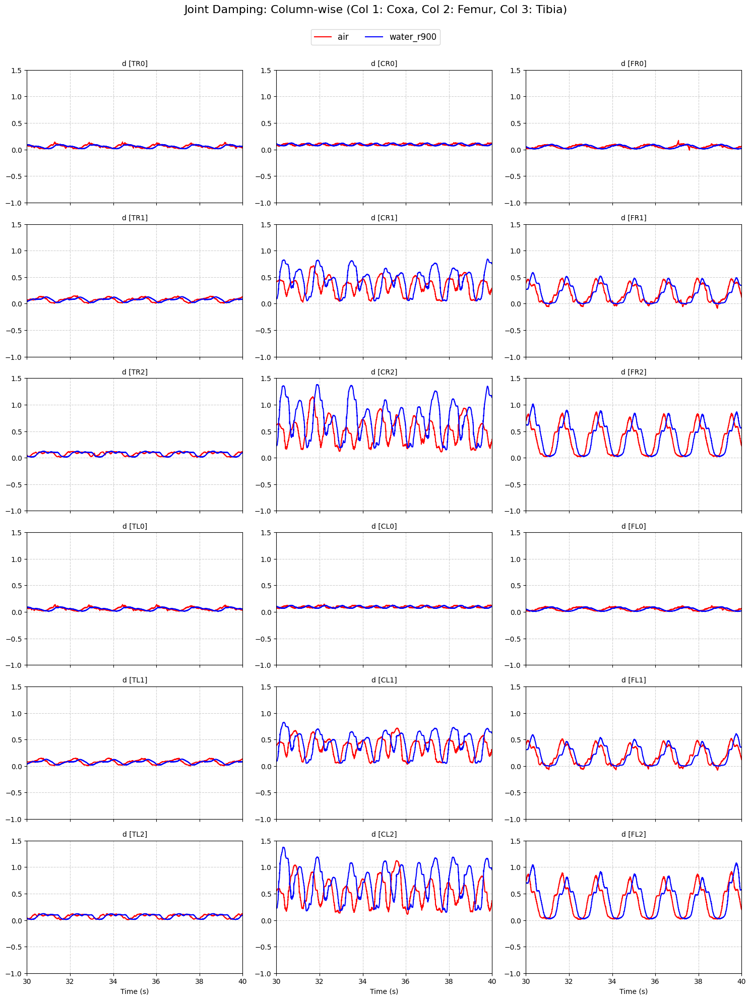

In [168]:
import matplotlib.pyplot as plt

# Define colors
colors = {
    'air': 'red',
    'water_r900': 'blue',
    'water_r1200': 'dodgerblue',
    'water_r1800': 'darkblue'
}

# Create the figure and axes (6 Rows x 3 Cols)
# figsize=(width, height) - adjusted to look similar to your Plotly height
fig, axs = plt.subplots(nrows=6, ncols=3, figsize=(15, 20), sharex=True)

# Flatten axes for easier iteration if needed, but we can access via [r, c]
# Set a main title
fig.suptitle("Joint Damping: Column-wise (Col 1: Coxa, Col 2: Femur, Col 3: Tibia)", fontsize=16)

# Lists to track if we have added labels to the legend yet
added_legend = False

for joint in name_joints:
    # --- 1. DETERMINE ROW & COLUMN (0-indexed) ---
    
    # Column Logic (Joint Type)
    if 'T' in joint:   c = 0 # Coxa
    elif 'C' in joint: c = 1 # Femur
    elif 'F' in joint: c = 2 # Tibia
    else: continue

    # Row Logic (Leg ID)
    if 'R0' in joint:   r = 0
    elif 'R1' in joint: r = 1
    elif 'R2' in joint: r = 2
    elif 'L0' in joint: r = 3
    elif 'L1' in joint: r = 4
    elif 'L2' in joint: r = 5
    else: continue

    # Select the specific subplot axis
    ax = axs[r, c]
    
    # --- 2. PLOT DATA ---
    # We only add the 'label' argument for the first plot we draw (r==0 and c==0)
    # This prevents the legend from having 18 duplicate entries.
    show_label = (r == 0 and c == 0)

    ax.plot(air_joint_damping_fb_df['ts'], air_joint_damping_fb_df[joint], 
            color=colors['air'], label='air' if show_label else "")
            
    ax.plot(water_r900_joint_damping_fb_df['ts'], water_r900_joint_damping_fb_df[joint], 
            color=colors['water_r900'], label='water_r900' if show_label else "")
            
#     ax.plot(water_r1200_joint_damping_fb_df['ts'], water_r1200_joint_damping_fb_df[joint], 
#             color=colors['water_r1200'], label='water_r1200' if show_label else "")
            
#     ax.plot(water_r1800_joint_damping_fb_df['ts'], water_r1800_joint_damping_fb_df[joint], 
#             color=colors['water_r1800'], label='water_r1800' if show_label else "")

    # Set Title for this specific subplot
    ax.set_title(f"d [{joint}]", fontsize=10)
    ax.grid(True, linestyle='--', alpha=0.6)
    ax.set_xlim(30, 40)  
    ax.set_ylim(-1, 1.5) 
# --- 3. GLOBAL LAYOUT SETTINGS ---

# Add a single global legend at the top
# We pull the handles/labels from the very first axis (axs[0,0])
handles, labels = axs[0, 0].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 0.96), ncol=4, fontsize=12)

# Adjust layout to prevent overlap (leaving space for title/legend)
plt.tight_layout(rect=[0, 0, 1, 0.95]) 

# Add common X-axis label at the bottom
# (Optional: Iterating through bottom row to set xlabel)
for ax in axs[-1, :]:
    ax.set_xlabel("Time (s)")

plt.show()